<div style="width:60%;text-align:center">
    <h1>
        Actividad integradora
    </h1>
    <h2>
        Daniel Gutiérrez Gómez A01068056
    </h2>

</div>

<div style="width:60%;text-align:center">
    <p>
        Felicidades! Eres el orgulloso propietario de 5 robots nuevos y un almacén lleno de cajas. 
        El dueño anterior del almacén lo dejó en completo desorden, por lo que depende de tus robots organizar las
        cajas en algo parecido al orden y convertirlo en un negocio exitoso.
    </p>
    <p>
        Cada robot está equipado con ruedas omnidireccionales y, por lo tanto, puede conducir en las cuatro direcciones.
        Pueden recoger cajas en celdas de cuadrícula adyacentes con sus manipuladores, luego llevarlas a otra ubicación e
        incluso construir pilas de hasta cinco cajas. Todos los robots están equipados con la tecnología de sensores más
        nueva que les permite recibir datos de sensores de las cuatro celdas adyacentes. Por tanto, es fácil distinguir 
        si un campo está libre, es una pared, contiene una pila de cajas (y cuantas cajas hay en la pila) o está ocupado
        por otro robot. Los robots también tienen sensores de presión equipados que les indican si llevan una caja en ese momento.
    </p>
    <p>
        Lamentablemente, tu presupuesto resultó insuficiente para adquirir un software de gestión de agentes múltiples de
        última generación. Pero eso no debería ser un gran problema ... ¿verdad? Tu tarea es enseñar a sus robots cómo
        ordenar su almacén. La organización de los agentes depende de ti, siempre que todas las cajas terminen en pilas ordenadas de cinco.
    </p>
</div>
<div style="width:60%;text-align:center">
    <h1>
        Puntos a considerar
    </h1>
    <ul>
        <li>
            La semilla para generación de números aleatorios será 67890.
        </li>
        <li>
            El almacén es 20x20 celdas.
        </li>
        <li>
            Al inicio de la simulación, tu solución deberá colocar 200 cajas repartidas en grupos de 1
             a 3 cajas en posiciones aleatorias.
        </li>
        <li>
            Todos los robots empiezan en posiciones aleatorias vacías. 
            Y, sólo puede haber un robot por celda.
        </li>
        <li>
            La simulación termina cuando todas las cajas se encuentra apiladas en pilas
             de exactamente 5 cajas.
        </li>
    </ul>
</div>

<div style="width:60%;text-align:center">
    <h1>
        ¿Qué se debe entregar?
    </h1>
    <ul>
        <li>
            Código fuente documentado
        </li>
        <li>
            Descripción detallada de la estrategia y los mecanismos utilizados en tu solución.
        </li>
        <li>
            Al inicio de la simulación, tu solución deberá colocar 200 cajas repartidas en grupos de 1
             a 3 cajas en posiciones aleatorias. (Modelo)
        </li>
        <li>
            El número de pasos necesarios para terminar la simulación
        </li>
        <li>
            ¿Existe una forma de reducir el número de pasos utilizados? Si es así, ¿cuál es la estrategia que se tendría en implementar?
        </li>
    </ul>
</div>
<div style="width:60%;text-align:center"> 
    <h1 style="text-align:center">Algoritmo Utilizado</h1>
    <ul>
        <ol>
            <li>Si no estás cargando caja, verifica las celdas adyacentes.</li>
            <li>Si hay un agente en la celda adyacente, no puedes moverte a esa posición.</li>
            <li>Si hay una caja en la celda adyacente, realiza las siguientes acciones:
                <ol type="i">
                    <li>Recoge la caja.</li>
                    <li>Marca esa casilla con -1.</li>
                    <li>Asígnate ese valor, siempre y cuando no estés cargando una caja, y el valor sea mayor a 0 y menor a 5.</li>
                </ol>
            </li>
        </ol>
        <ol>
            <li>Si estás cargando caja, verifica las celdas adyacentes.</li>
            <li>Si hay un agente en la celda adyacente, no puedes moverte a esa posición.</li>
            <li>Si hay una caja en la celda adyacente, realiza las siguientes acciones:
                <ol type="a">
                    <li>Revisa que sea igual o mayor a la que has dejado.</li>
                    <li>Marca esa casilla con +1.</li>
                    <li>Asígnate un valor de 0, siempre y cuando la celda no sobrepase los 5.</li>
                    <li>Además, revisa el contador de total stacks:
                        <ul>
                            <li>Si es igual a 4 en esa casilla, aumenta el total stacks.</li>
                        </ul>
                    </li>
                </ol>
            </li>
            <li>Si ya hay 39 stacks, puede pasar que los agentes tengan 5 cajas. Para esto, realizar dos funciones que ayuden a dejar esa caja en una celda aleatoria con valor 0, y todos los agentes irán a dejar sus cajas en esa posición con ruta Manhattan.</li>
        </ol>
    </ul>

</div>

<h1 style="text-align:center">Librerías utilizadas</h1>

In [2]:
# Importamos las clases que se requieren para manejar los agentes (Agent) y su entorno (Model).
# Cada modelo puede contener múltiples agentes.
from typing import Any
from mesa import Agent, Model 

# Debido a que necesitamos que existe un solo agente por celda, elegimos ''SingleGrid''.
from mesa.space import SingleGrid

# Con ''RandomActivation, hacemos que los agentes se activen ''uno a uno de manera aleatoria en cada step del modelo''.
from mesa.time import RandomActivation

# Haremos uso de ''DataCollector'' para obtener información de cada paso de la simulación.
from mesa.datacollection import DataCollector

# matplotlib lo usaremos crear una animación de cada uno de los pasos del modelo.
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.animation as animation
plt.rcParams["animation.html"] = "jshtml"
matplotlib.rcParams['animation.embed_limit'] = 2**128

# Importamos los siguientes paquetes para el mejor manejo de valores numéricos.
import numpy as np
import pandas as pd

# Definimos paquetes para medir el tiempo del algoritmo
import time
import datetime

# Definimos librerías para hacer typing y para obtener un valor de mínima distancia
from typing import Tuple
import math
from operator import itemgetter

<h1 style="text-align:center">Clase de Agente</p1>

In [3]:
# Clase que simboliza al agente
class BoxPickerAgent(Agent):
    def __init__(self, unique_id: int, model: Model) -> None:
        super().__init__(unique_id, model)
        self.isCarryingBox = False
        self.numberBoxes = 0
        self.random.seed(67890)
    
    def step(self) -> None:
        # If the last box has been communicated and the agent is carrying a box
        if self.model.coordsLastOne and self.isCarryingBox:
            result = self.putLastOne()
            if result is not None:
                (moveX, moveY) = result
                if self.model.grid.is_cell_empty((moveX, moveY)):
                    self.model.grid.move_agent(self, (moveX, moveY))
        
        # If the last box has been communicated and the agent is not carrying a box
        elif self.model.coordsLastOne and not self.isCarryingBox:
            neighborRandom = self.model.grid.get_neighborhood(self.pos, moore=False, include_center=False)
            lastX, lastY = self.model.coordsLastOne
            self.checkLast(lastX, lastY, neighborRandom)
        
        # If the agent is not carrying a box and the last box has not been communicated
        else:
            if not self.isCarryingBox and not self.numberBoxes == -1:
                newCoords = self.checkRandomlyNoCarrying()
                if newCoords is not None:
                    (newX, newY) = newCoords
                    # Only move if it is possible in this step
                    if self.model.grid.is_cell_empty((newX, newY)):
                        self.model.grid.move_agent(self, (newX, newY))
        
            # If the agent is carrying a box and the last box has not been communicated
            elif self.isCarryingBox and not self.numberBoxes == -1:
                newCoords = self.checkRandomlyCarrying()
                if newCoords is not None:
                    (newX, newY) = newCoords
                    # If not carrying a box, it means it has already been moved randomly
                    if not self.isCarryingBox and self.model.floorBoxes[newX][newY] == 0:
                        if self.model.grid.is_cell_empty((newX, newY)):
                            self.model.grid.move_agent(self, (newX, newY))
                    # If carrying a box and there is a possible step, move
                    elif self.isCarryingBox and self.model.floorBoxes[newX][newY] == 0:
                        if self.model.grid.is_cell_empty((newX, newY)):
                            self.model.grid.move_agent(self, (newX, newY))

    # Poner la última con la ruta más cercana
    # ruta Manhattan una vez comunicada la última caja
    def putLastOne(self) -> Tuple:
        neighborRandom: list[Tuple] = self.checkNeighborhood()
        
        lastX, lastY = self.model.coordsLastOne
        emptyCells: list = []
        for step in neighborRandom:
            newX, newY = step
            if self.checkEmptyNeigh(newX, newY) and self.model.floorBoxes[newX][newY] == 0:
                distance = abs(newX - lastX) + abs(newY - lastY)
                emptyCells.append((distance, newX, newY))
            elif self.checkPutLast(newX, newY, lastX, lastY):
                if (self.model.floorBoxes[newX][newY] == 4):
                    self.model.totalStacks += 1
                self.numberBoxes = -1
                self.model.floorBoxes[newX][newY] += 1
                self.isCarryingBox = False # Revisar
                self.model.currentBoxes -= 1
        if emptyCells:
            # Find the neighbor with the minimum distance using itemgetter
            min_distance_neighbor = min(emptyCells, key=itemgetter(0))
            return min_distance_neighbor[1], min_distance_neighbor[2]
        return None
    
    # Checar para moverte random si no cargas caja
    # Tomar caja moverla a una que tenga lo mismo
    def checkRandomlyNoCarrying(self) -> Tuple:
        neighborRandom: list[Tuple] = self.checkNeighborhood()
        possibleSteps: list = []
        for (neighX, neighY) in neighborRandom:
            # No te puedes mover a esa posición hay un agente
            if not self.checkEmptyNeigh(neighX, neighY):
                continue
            elif self.model.floorBoxes[neighX][neighY] == 0:
                possibleSteps.append((neighX, neighY))
            elif self.checkConditionalNotCarrying(neighX, neighY):
                self.model.floorBoxes[neighX][neighY] -= 1
                self.numberBoxes = self.model.floorBoxes[neighX][neighY]
                self.isCarryingBox = True
                self.model.currentBoxes += 1
        if len(possibleSteps) > 0:
            return self.random.choice(possibleSteps)
        return None

    # Checar pasos para saber movimientos cuando trae caja
    def checkRandomlyCarrying(self) -> Tuple:
        neighborRandom: list[Tuple] = self.checkNeighborhood()
        # Ver los pasos posibles una vez que se dejó la caja para mover si es que se puede
        # Solo dejar la caja si es igual o mayor a 3 y menor a 5
        possibleSteps: list = []
        for (neighX, neighY) in neighborRandom:
            if self.checkConditionLastToPut(neighX, neighY):
                self.model.floorBoxes[neighX][neighY] += 1
                self.model.coordsLastOne = neighX, neighY
                self.isCarryingBox = False
                self.numberBoxes = -1
                self.model.currentBoxes -= 1
            if not self.model.grid.is_cell_empty((neighX, neighY)):
                continue
            elif self.model.floorBoxes[neighX][neighY] == 0:
                possibleSteps.append((neighX, neighY))
            elif self.checkConditionalCarrying(neighX, neighY):
                if (self.model.floorBoxes[neighX][neighY] == 4):
                    self.model.totalStacks += 1
                self.model.currentBoxes -= 1
                self.model.floorBoxes[neighX][neighY] += 1
                self.isCarryingBox = False
                self.numberBoxes = 0

        if len(possibleSteps) > 0:
            return self.random.choice(possibleSteps)
        return None
    
    # Si es la última caja, ir por más cajas y solo llevarla a la última ubicación
    def checkLast(self, lastX, lastY, neighborRandom) -> Tuple:
        emptyCells: list = []
        for (neighX, neighY) in neighborRandom:
            if not self.checkEmptyNeigh(neighX, neighY):
                continue
            elif self.model.floorBoxes[neighX][neighY] == 0:
                emptyCells.append((neighX, neighY))
            
            ## Tomar todas las cajas excepto de la útlima posición y llevarlas a ultima ubicacion
            elif self.checkLastBox(neighX, neighY, lastX, lastY):
                self.model.floorBoxes[neighX][neighY] -= 1
                self.numberBoxes = self.model.floorBoxes[neighX][neighY]
                self.isCarryingBox = True
                self.model.currentBoxes += 1
        if len(emptyCells) > 0:
            cellX, cellY = self.random.choice(emptyCells)
            if self.checkEmptyNeigh(cellX, cellY):
                self.model.grid.move_agent(self,(cellX, cellY))
                
    # Mover random
    def moveRandomly(self) -> None:
        # Obtener vecindades
        possibleSteps: list[Tuple] = self.checkNeighborhood()

        emptySteps: list[Tuple] = [
            step for step in possibleSteps if self.model.grid.is_cell_empty(step)]
        
        if emptySteps:
            newPosition = self.random.choice(emptySteps)
            newX, newY = newPosition
            if self.checkEmptyNeigh(newX, newY):
                self.model.grid.move_agent(self, (newX, newY))
                
    # Checar las vecindades en Von Neuman
    def checkNeighborhood(self) -> list[Tuple]:
        return self.model.grid.get_neighborhood(self.pos, moore=False, include_center=False)
    
    # Checar vecindades que estén vacías
    def checkEmptyNeigh(self, coord1, coord2) -> bool:
        return self.model.grid.is_cell_empty((coord1, coord2))
    
    # Helper para condicional
    def checkConditionLastToPut(self, coord1, coord2) -> bool:
        return self.model.currentBoxes == 5  and self.model.totalStacks == 39 and self.checkEmptyNeigh(coord1, coord2) and self.model.floorBoxes[coord1][coord2] == 0 and not self.model.coordsLastOne and self.isCarryingBox
    
    # Helper para condicional levantar caja
    def checkConditionalNotCarrying(self, coord1, coord2) -> bool:
        return self.model.floorBoxes[coord1][coord2] >= 1 and self.model.floorBoxes[coord1][coord2] < 5 and not self.isCarryingBox
        
    # Helper para condicional levantar caja
    def checkConditionalCarrying(self, coord1, coord2) -> bool:
        return self.model.floorBoxes[coord1][coord2] >= 1 and self.model.floorBoxes[coord1][coord2] < 5 and self.model.floorBoxes[coord1][coord2] >= self.numberBoxes and self.isCarryingBox
    
    # Helper para condicional última caja
    def checkLastBox(self, coord1, coord2, lastX, lastY) -> bool:
        return self.model.floorBoxes[coord1][coord2] > 0 and self.model.floorBoxes[coord1][coord2] < 5 and coord1 != lastX and coord2 != lastY and not self.isCarryingBox
    
    # Helper poner última caja
    def checkPutLast(self, coord1, coord2, lastX, lastY) -> bool:
        return coord1 == lastX and coord2 == lastY and self.model.floorBoxes[coord1][coord2] < 5 and self.isCarryingBox and self.model.floorBoxes[coord1][coord2] > 0

<h1 style="text-align:center">Clase de Modelo</p1>

In [4]:
# Clase que simboliza el modelo
class BoxPicker(Model):
    def __init__(self, A: int, W: int, H: int, numBoxes: int) -> None:
        self.A = A
        self.W = W
        self.H = H
        self.numBoxes = numBoxes
        
        # Activación entorno con mesa
        self.schedule = RandomActivation(self)
        self.grid = SingleGrid(W, H, False)
        self.datacollector = DataCollector(model_reporters={"Boxes": self.getFloor,
                                                            "Agents": self.getAgents})
        
        # Diccionario para hacer búsqueda con comunicación con agentes (NICE TO HAVE OPTIMIZATION)
        self.positionBoxes = {}
        self.currMax = 0
        
        # Random seed
        self.random.seed(67890)
        
        # Count stacks
        self.totalStacks = 0
        self.coordsLastOne = ()
        self.lastStack = 0
        self.currentBoxes = 0;
        
        # Model steps 
        self.steps = 0

        # Creación de capa para colocar cajas
        self.floorBoxes = np.zeros((W, H))
        
        # Helper para saber cantidad de cajas antes y después de ejecución en rango (1, 4]
        self.generateBoxesFloor()
        self.count = lambda sum_matrix: (sum(self.countOneTwoThree(num) for num in sum_matrix.flatten()))

        # Set para posicionar agentes
        self.positionedAgents = set()
        # Para cada agente posicionar en casillas donde no hay cajas
        for i in range(self.A):
            x: int = np.random.randint(0, self.W)
            y: int = np.random.randint(0, self.H)
            
            # Si hay cajas en esa posición, buscar otras posiciones random
            if(self.floorBoxes[x][y] > 0):
                while(self.floorBoxes[x][y] > 0 and (x, y) in self.positionedAgents):
                    x: int = np.random.randint(0, self.W)
                    y: int = np.random.randint(0, self.H)
            
            # Posicionar agente en casillas sin cajas
            a: int = BoxPickerAgent(i + 1, self)
            self.schedule.add(a)
            self.grid.place_agent(a, (x, y))
            self.positionedAgents.add((x, y))
    
    # Obtener agentes
    def getAgents(self) -> np:
        agentsPosition = np.zeros((self.W, self.H))
        for agent in self.schedule.agents:
            x, y = agent.pos
            agentsPosition[x][y] = 1
        return agentsPosition
    
    # Generar cajas en pilas de tres menor a 200
    def generateBoxesFloor(self) -> None:
        maxBoxes: int = 200
        min: int = 1
        max: int = 3
        while maxBoxes > 0:
            x = np.random.randint(0, self.W)
            y = np.random.randint(0, self.H)
            randomNumber = np.random.randint(min, max)
            while ((maxBoxes-randomNumber) < 0):
                randomNumber = np.random.randint(min, max)
            if self.floorBoxes[x][y] == 0 and randomNumber:
                self.floorBoxes[x][y] = randomNumber
                maxBoxes -= randomNumber
            
    # Obtener copia de matriz del suelo en cada step
    def getFloor(self) -> np:
        return np.copy(self.floorBoxes)
    
    # Helper para lambda fn
    def countOneTwoThree(self, n) -> int:
        if n in range(1, 4):
            return n
        else:
            return 0
    
    # Step para guardar información del datacollector y mostrar figura
    def step(self):
        self.steps+=1
        self.datacollector.collect(self)
        self.schedule.step()

<h1 style="text-align:center">Recolección de información del modelo y agentes</p1>

In [26]:
WIDTH = 20
HEIGHT = 20
NUM_ROBOTS = 5
TOTAL_BOXES = 200
ITER = 30000
STOP_ITER = 0
TOTAL_COUNT = 0
START_TIME = time.time()

model = BoxPicker(NUM_ROBOTS, WIDTH, HEIGHT, TOTAL_BOXES)
print("Cantidad de cajas antes de simulación: (rango 1 a 4]: ", model.count(model.floorBoxes))

for i in range(ITER):
    model.step()
    if model.totalStacks == 40:
        STOP_ITER = i
        print("Se llenaron las pilas con 5")
        break

def countFive(number):
    return 1 if number == 5 else 0

print("Cantidad de cajas después de simulación: (rango 1 a 4]: ", model.count(model.floorBoxes))

if STOP_ITER:
    x = lambda np_array: (sum(countFive(num) for num in np_array.flatten()))
    print("Cajas llenadas", x(model.floorBoxes), " con los siguientes pasos: ", STOP_ITER)
    # Imprimimos el tiempo que le tomó correr al modelo.
    print('Tiempo de ejecución:', str(datetime.timedelta(seconds=(time.time() - START_TIME))))

# Imprimimos el tiempo que le tomó correr al modelo.
print('Tiempo de ejecución:', str(datetime.timedelta(seconds=(time.time() - START_TIME))))



Cantidad de cajas antes de simulación: (rango 1 a 4]:  200.0
Se llenaron las pilas con 5
Cantidad de cajas después de simulación: (rango 1 a 4]:  0
Cajas llenadas 40  con los siguientes pasos:  2540
Tiempo de ejecución: 0:00:00.199587
Tiempo de ejecución: 0:00:00.199689


<h1 style="text-align:center">Animación de información recolectada</p1>

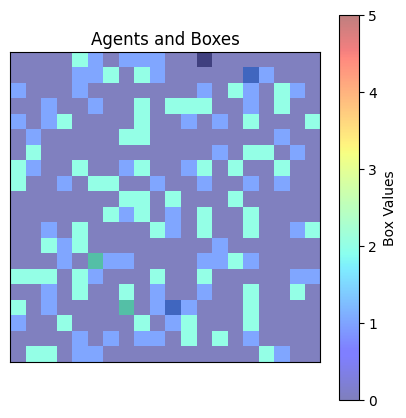

In [27]:
# Recolección del data collector
all_data = model.datacollector.get_model_vars_dataframe()

# Obtención de datos de los agentes y las cajas
AgentData = all_data.get("Agents")
BoxesData = all_data.get("Boxes")

# Cuantas iteraciones se harán para el plot
STOP_ITER = len(all_data)

# Función para dar animación
def animate(i):
    agent_patch.set_data(AgentData[i])
    box_patch.set_data(BoxesData[i])
    agent_patch.set_clim(vmin=0, vmax=1)
    box_patch.set_clim(vmin=0, vmax=5)

    return agent_patch, box_patch

fig, axis = plt.subplots(figsize=(5, 5))
axis.set_title("Agents and Boxes")
axis.set_xticks([])
axis.set_yticks([])

# Realizar animación de datos
agent_patch = axis.imshow(AgentData[0], cmap="Greys", alpha=0.5, vmin=0, vmax=1)
box_patch = axis.imshow(BoxesData[0], cmap="jet", alpha=0.5, vmin=0, vmax=5)

# Agregación de un colorbar para la información de las cajas
cbar = plt.colorbar(box_patch)
cbar.set_label("Box Values")

# Creación de leyenda
legend_labels = [f"Value {int(i)}" for i in range(0, 6)]
legend_colors = plt.cm.jet(range(0, 6))
legend_patches = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=10) for color in legend_colors]

anim = animation.FuncAnimation(fig, animate, frames=STOP_ITER if STOP_ITER else i, interval=100)
anim

<div style="width:60%;text-align:center"> 
    <h1 style="text-align:center">Planteación de optimización</h1>
    <li>
        ¿Existe una forma de reducir el número de pasos utilizados? Si es así, ¿cuál es la estrategia que se tendría en implementar?
        <p> Sí la hay, se me ocurre que cada celda tenga asociada su posición y la cantidad de cajas que tiene, se me ocurre que los agentes</p>
        <p> Busquen todas las cajas primero, comunican y después empiezan a moverlas, teniendo en cuenta las posiciones y la cantidad</p>
        <p> Para esto, deberían de también los agentes saber la ruta más cercana a una casilla que tenga más o la misma cantidad que de la caja que viene</p>
        <p> Similar a mi implementación pero con el uso de un diccionario con pesos y posiciones (teoría de grafos, PRIMs o Dijkstra)</p>
    </li>
</h1>